In [12]:
import os
from PIL import Image
import cv2
import numpy as np  
import matplotlib.pyplot as plt
import math

In [13]:
# Set the paths to the positive images and groundtruth folders
positive_images_path = '../dataset/positive_images'
groundtruth_path = '../dataset/groundtruth'

# Get a list of all the tif images in the positive images folder
tif_images = [f for f in os.listdir(positive_images_path) if f.endswith('.tif')]

In [14]:
len(tif_images)

107

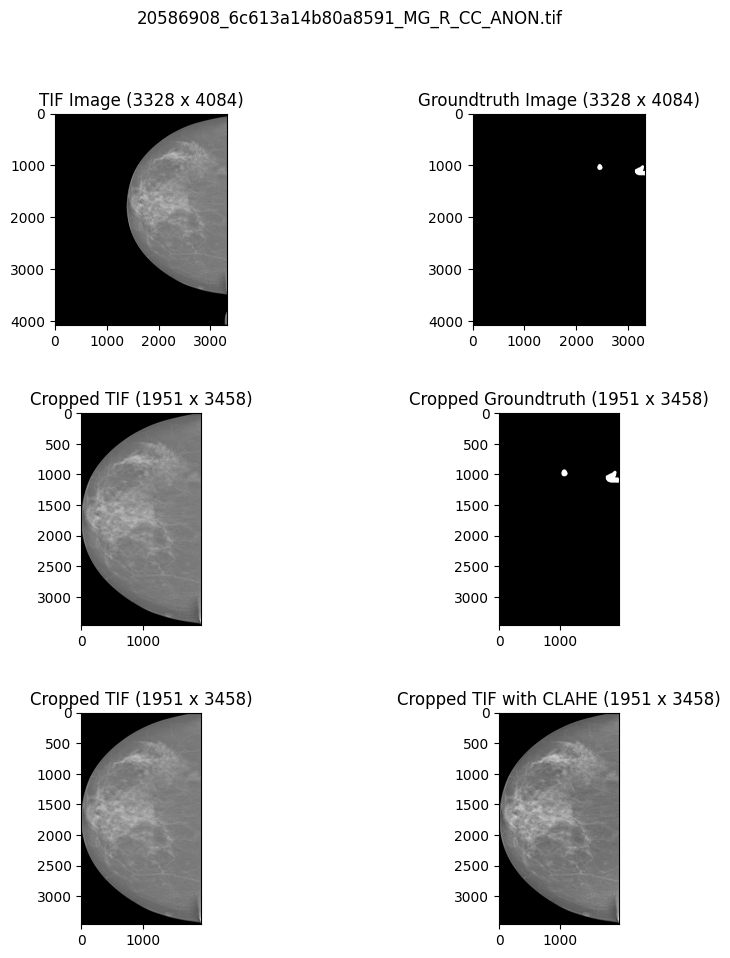

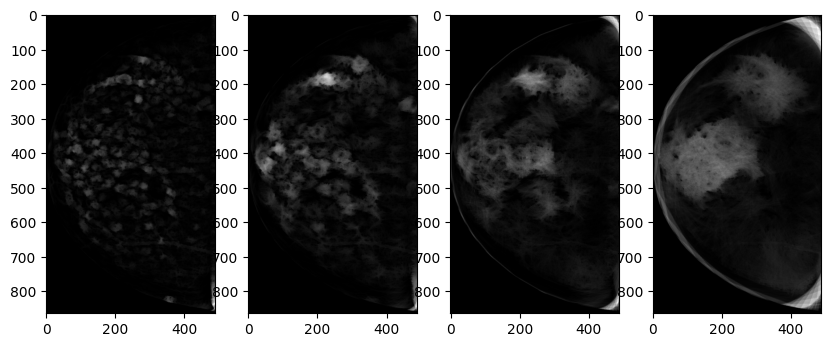

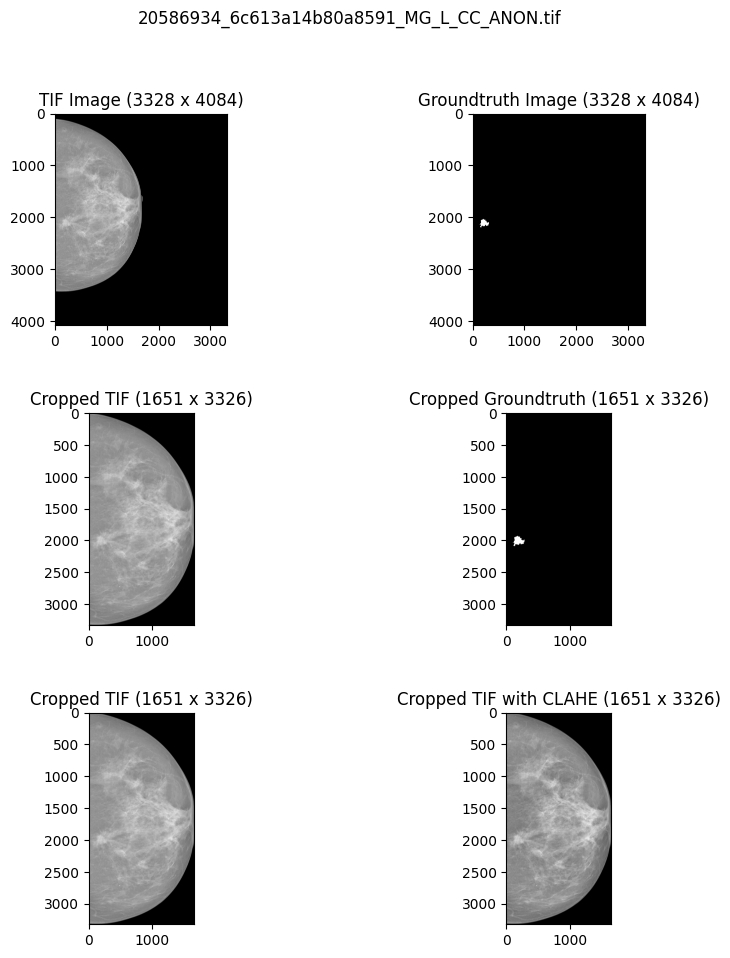

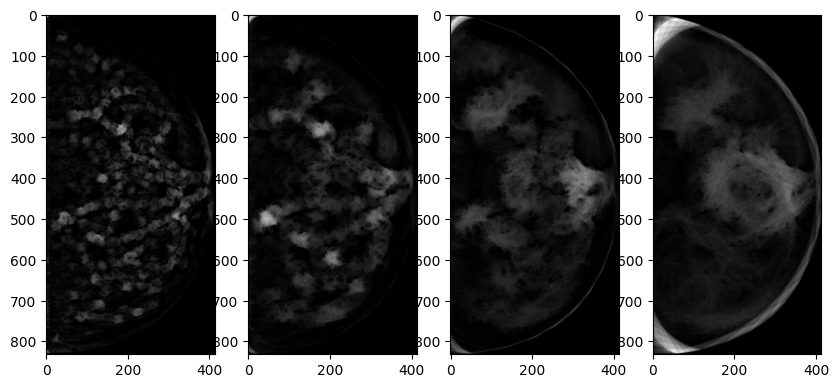

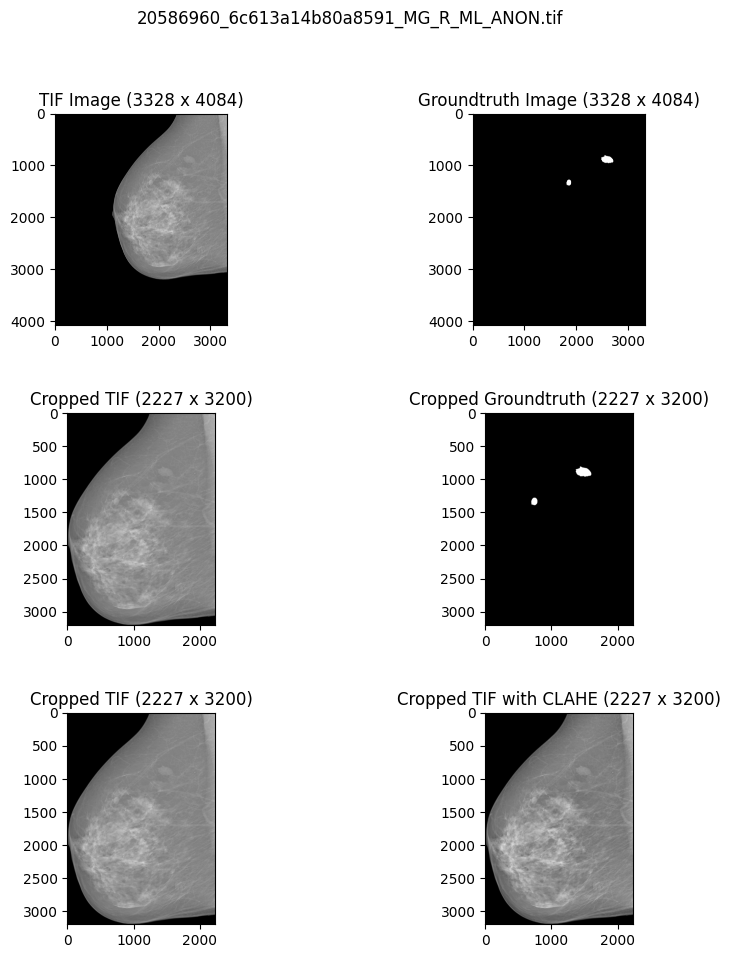

...

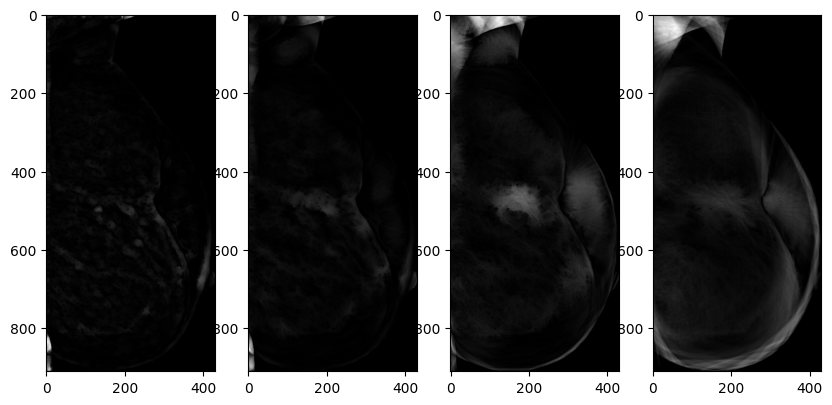

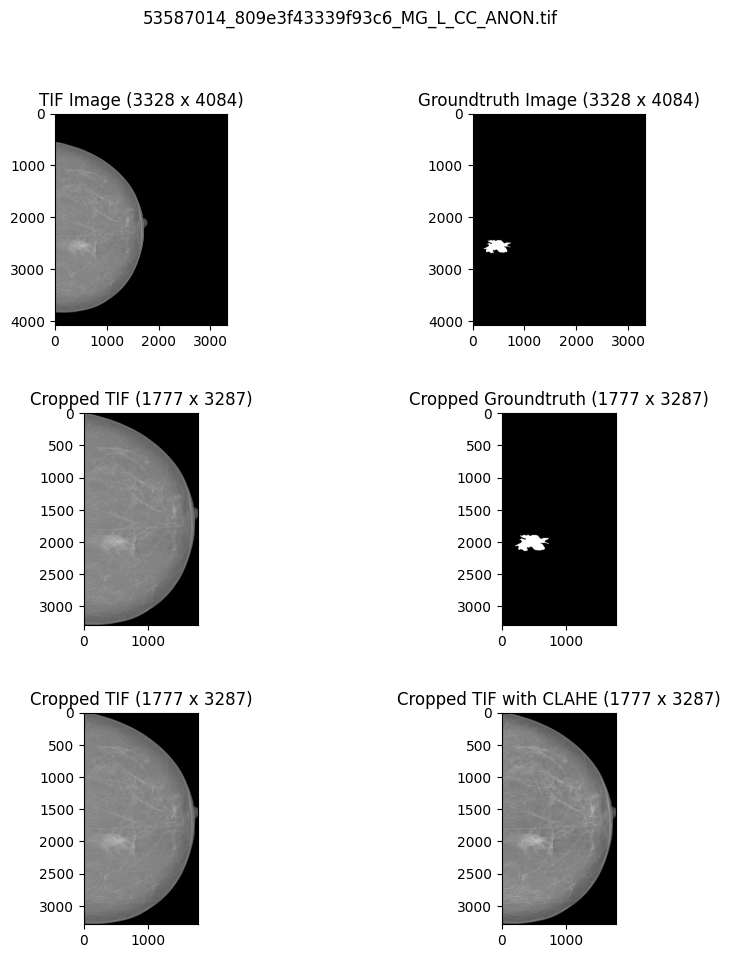

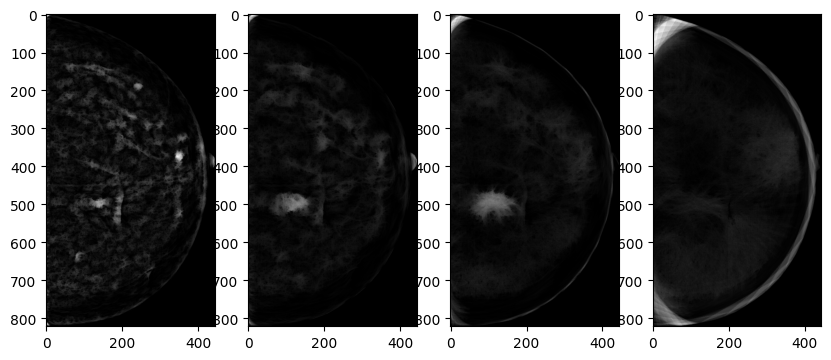

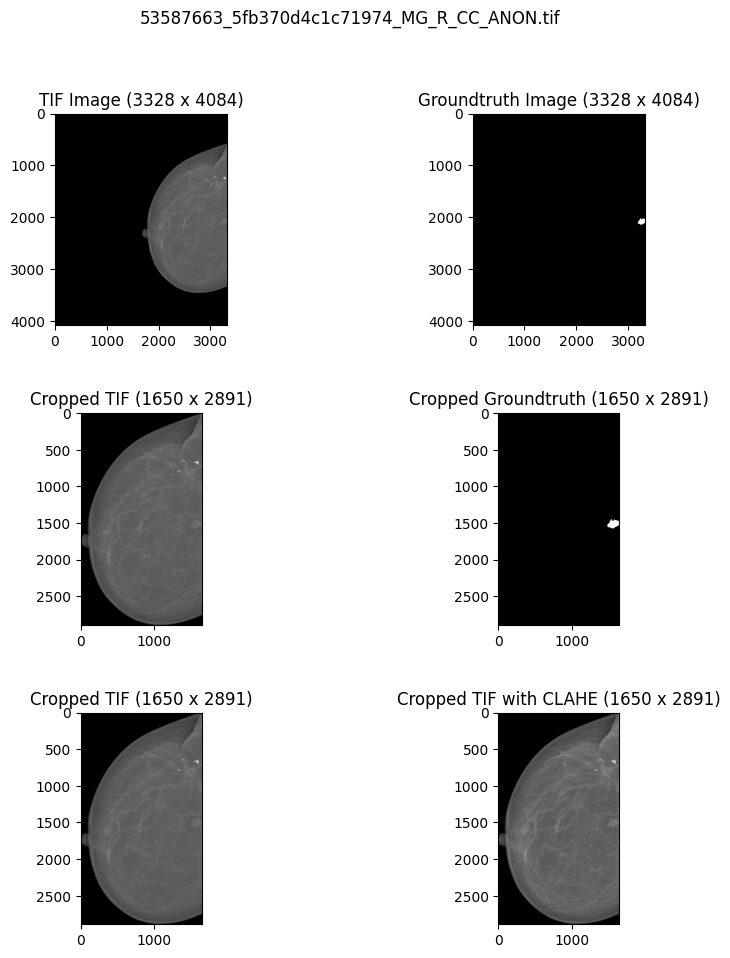

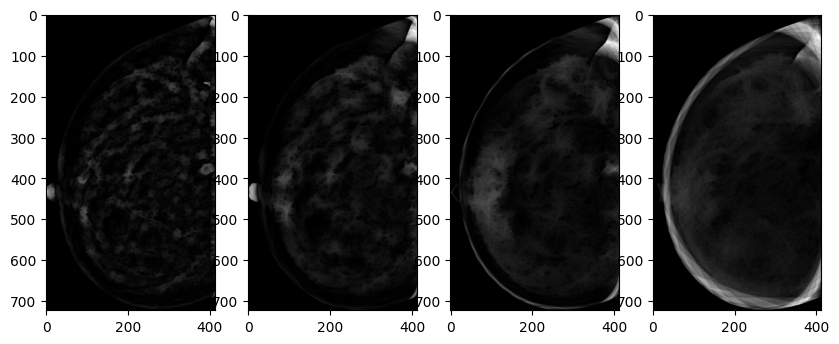

In [15]:
# Otsu thresholding function
def Otsu_thresholding(img):
    # Gaussian Filtering
    blur = cv.GaussianBlur(img, (5,5), 0)
    _, breast_mask = cv.threshold(blur, 0, 255, cv.THRESH_BINARY + cv.THRESH_OTSU)
    cnts, _ = cv.findContours(breast_mask.astype(np.uint8), cv.RETR_EXTERNAL, cv.CHAIN_APPROX_SIMPLE)
    cnt = max(cnts, key = cv.contourArea)
    x, y, w, h = cv.boundingRect(cnt)
    return x, y, w, h

# Contrast-Limited Adaptive Histogram Equalization (CLAHE) Function
def clahe(image,clip=0.9,tile=1):
    clahe = cv.createCLAHE(clipLimit=clip, tileGridSize=(tile,tile))                                             
    return clahe.apply(image)

# Generate Morphological Kernels for Sifting
def generate_rotated_kernel(D, delta_theta):
    kernel = np.zeros((D,D),dtype=int)
    for j in range(0,(D)):                                                               # Generate Kernel
        kernel[int(D/2)][j] = 1
    rows,cols      = kernel.shape
    rotmat         = cv2.getRotationMatrix2D((int(D/2),int(D/2)), delta_theta, 1.0);     # Generate Rotation Matrix
    rotated_kernel = cv2.warpAffine(np.uint8(kernel), rotmat, (cols,rows));              # Rotate Kernel Around its Center
    rotated_kernel = np.delete(rotated_kernel,np.argwhere(np.all(rotated_kernel[..., :] == 0, axis=0)), axis=1)
    rotated_kernel = np.delete(rotated_kernel,np.where(~rotated_kernel.any(axis=1))[0], axis=0)
    return rotated_kernel

# Multi-Scale Morphological Sifting
def multi_scale_morphological_sifters(input_img ,M, N, Areamin, Areamax, PixelSize):
    SI = np.zeros((M+1), dtype=float) # Scale Interval
    D1 = np.zeros((M), dtype=int)     # Outer Diameter
    D2 = np.zeros((M), dtype=int)     # Inner Diameter

    # Calculate Minimum/Maximum Diameter
    DImin = 2 * math.sqrt(Areamin/math.pi)/(PixelSize*4)  
    DImax = 2 * math.sqrt(Areamax/math.pi)/(PixelSize*4)
    
    SI[0] = 1.   # Minimum Dimention in First Iteration
    
    # Calculate Diameters D1,D2
    for i in range(1,M+1):
        SI[i] = ((DImax/DImin)**(1/M))**(i)
    for i in range(0,M):
        D1[i] = np.round(DImin * SI[i])
        if ((D1[i]%2) == 0):  # Ensure Odd-Numbered Diameter to use as Kernel Filter
            D1[i]+=1;
        D2[i] = np.round(DImin * SI[i+1])
        if ((D2[i]%2) == 0):  # Ensure Odd-Numbered Diameter to use as Kernel Filter
            D2[i]+=1;
    
    # Placeholder for Summing Image    
    sum_all_images = np.zeros((M,input_img.shape[0],input_img.shape[1]), dtype=int)
    for i in range(0,M):
        for delta_theta in range(0,180,int(180/N)):
            
            # Apply Top-Hat Transform using Outer Diameter Line
            rotated_kernel = generate_rotated_kernel(D2[i], delta_theta)
            dst1           = cv2.morphologyEx(input_img, cv2.MORPH_TOPHAT, rotated_kernel)
    
            # Apply Morphological Opening using Inner Diameter Line
            rotated_kernel = generate_rotated_kernel(D1[i], delta_theta)
            dst2           = cv2.morphologyEx(dst1, cv2.MORPH_OPEN, rotated_kernel)
            
            sum_all_images[i,:,:] = sum_all_images[i,:,:] + dst2;
        sum_all_images[i,:,:] = (sum_all_images[i,:,:]/np.max(sum_all_images[i,:,:]))*(2**16-1) # Normalize Output Image
    return sum_all_images

plt.rcParams['figure.max_open_warning'] = False

# Iterate over each TIF image and crop it along with its corresponding groundtruth image using the Otsu thresholding method
for tif_image in tif_images:
    # Load the TIF image
    tif_image_path = os.path.join(positive_images_path, tif_image)
    tif_image_pil = Image.open(tif_image_path)
    tif_image_np = np.array(tif_image_pil)
    
    # Get the corresponding groundtruth image path
    groundtruth_image_path = os.path.join(groundtruth_path, tif_image)
    groundtruth_image_pil = Image.open(groundtruth_image_path)
    groundtruth_image_np = np.array(groundtruth_image_pil)
    
    # Apply Otsu thresholding to the TIF image
    x, y, w, h = Otsu_thresholding(tif_image_np)
    tif_image_cropped = tif_image_np[y:y+h, x:x+w]
    groundtruth_image_cropped = groundtruth_image_np[y:y+h, x:x+w]
    
    # Apply CLAHE to the cropped TIF image
    tif_image_cropped_clahe = clahe(tif_image_cropped, clip=8, tile=4)
    
    # Display the original and cropped TIF and groundtruth images along with their size
    fig, ax = plt.subplots(3, 2, figsize=(10, 10))
    fig.suptitle(tif_image)
    ax[0, 0].imshow(tif_image_np, cmap='gray')
    ax[0, 0].set_title('TIF Image ({} x {})'.format(tif_image_np.shape[1], tif_image_np.shape[0]))
    
    ax[0, 1].imshow(groundtruth_image_np, cmap='gray')
    ax[0, 1].set_title('Groundtruth Image ({} x {})'.format(groundtruth_image_np.shape[1], groundtruth_image_np.shape[0]))
    
    ax[1, 0].imshow(tif_image_cropped, cmap='gray')
    ax[1, 0].set_title('Cropped TIF ({} x {})'.format(tif_image_cropped.shape[1], tif_image_cropped.shape[0]))
    
    ax[1, 1].imshow(groundtruth_image_cropped, cmap='gray')
    ax[1, 1].set_title('Cropped Groundtruth ({} x {})'.format(groundtruth_image_cropped.shape[1], groundtruth_image_cropped.shape[0]))
    
    ax[2, 0].imshow(tif_image_cropped, cmap='gray')
    ax[2, 0].set_title('Cropped TIF ({} x {})'.format(tif_image_cropped.shape[1], tif_image_cropped.shape[0]))
            
    ax[2, 1].imshow(tif_image_cropped_clahe, cmap='gray')
    ax[2, 1].set_title('Cropped TIF with CLAHE ({} x {})'.format(tif_image_cropped_clahe.shape[1], tif_image_cropped_clahe.shape[0]))
    
    fig.tight_layout(pad=3.0)
    plt.show()
    
    # Apply multiscale morphological shifting to the cropped TIF image
    M = 4
    N = 18
    Areamin = 15
    Areamax = 3689
    PixelSize = 70/1000 # micrometers
    down_img = cv2.resize(tif_image_cropped_clahe, None, fx = 1/4, fy = 1/4, interpolation = cv2.INTER_CUBIC)
    sum_all_images = multi_scale_morphological_sifters(down_img, M, N, Areamin, Areamax, PixelSize)
    
    # Visualize the shifted images
    #for i in range(M):
        #plt.imshow(sum_all_images[i,:,:], cmap='gray')
        #plt.show()
        
    a, ax = plt.subplots(1, 4, figsize=(10, 10))
    ax[0].imshow(sum_all_images[0], cmap='gray')
    ax[1].imshow(sum_all_images[1], cmap='gray')
    ax[2].imshow(sum_all_images[2], cmap='gray')
    ax[3].imshow(sum_all_images[3], cmap='gray')
    plt.show()
        